<a href="https://colab.research.google.com/github/deepakri201/DICOMTagViz/blob/main/DICOMTagVizAndClassification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

This notebook performs both visualization and classification of the scan type in prostate MR collections across IDC.



---


# DICOM Tag visualization

---

This notebook contains experiments with different visualization tools for DICOM tag visualization. We take tags from DICOM data from prostate collections in IDC.

For now we look at T2 weighted axial collections, and see how the tags vary using the hiplot package. Later, we'd like to see if we can infer the series type (T2, DWI and ADC) based on these tags. We need to first understand the variability of the tags.

To do:
- Try streamlight package
- Try wanddb package

---
Notes:
- [hiplot](https://github.com/facebookresearch/hiplot)
- Important DICOM parameters extracted from IDC are from [this paper](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7256138/)

Other:
Trying to view html:

```
from pathlib import Path
import hiplot
hiplot_upload_html = hiplot.render.make_experiment_standalone_page({'dataProviderName': 'upload'})
Path('hiplot_prostate_t2.html').write_text(hiplot_upload_html)
```

On my local machine:
`hiplot-render D:\deepa\PW40\DICOMViz\hiplot_prostate_T2.csv > D:\deepa\PW40\DICOMViz\hiplot_prostate_T2.html`
open html in browser and can interact with plot!

---


Deepa Krishnaswamy

Brigham and Women's Hospital

January 2024

---



https://medium.com/@yuezhixiong915/visualize-decision-trees-in-random-forest-e8cc8e3d725a

# Parameterization

In [ ]:
#@title Enter your Project ID here
# initialize this variable with your Google Cloud Project ID!
project_name = "idc-external-018" #@param {type:"string"}

import os
os.environ["GCP_PROJECT_ID"] = project_name

!gcloud config set project $project_name

from google.colab import auth
auth.authenticate_user()

Updated property [core/project].


In [ ]:
location = 'us-central1'

# Environment setup

In [ ]:
import os

# Authorize
from google.colab import auth
auth.authenticate_user()
import subprocess
from google.colab import drive
drive.mount('/content/gdrive')


Mounted at /content/gdrive


In [ ]:
!pip install SimpleITK

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.7/52.7 MB 29.8 MB/s eta 0:00:00


In [ ]:
import os
import sys
import time
import re

from google.cloud import bigquery
import pandas as pd
from google.cloud import storage

import nibabel as nib
import numpy as np
import SimpleITK as sitk
import matplotlib.pyplot as plt

In [ ]:
import seaborn as sns

In [ ]:
!pip install -U hiplot
import hiplot as hip

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 863.2/863.2 kB 8.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 12.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 21.9 MB/s eta 0:00:00


In [ ]:
from scipy.spatial import distance

In [ ]:
import matplotlib.pyplot as plt

# Query for prostate MR data

In [ ]:
client = bigquery.Client(project=project_name)

query = """

WITH select_series AS(

      SELECT
        DISTINCT(SeriesInstanceUID) as SeriesInstanceUID,
        COUNT(SOPInstanceUID) as num_images,
        COUNT(DISTINCT(ARRAY_TO_STRING(ImageOrientationPatient,"/"))) AS orientation_count,
        COUNT(DISTINCT(ARRAY_TO_STRING(ImagePositionPatient,"/"))) AS position_count,
        STRING_AGG(DISTINCT(ARRAY_TO_STRING(ImageOrientationPatient, "/"))) AS orientations
      FROM
        `bigquery-public-data.idc_current.dicom_all`
      WHERE
        collection_id IN UNNEST(@collection_id_list) AND
        Modality = "MR"
      GROUP BY
        SeriesInstanceUID
        )

    SELECT
      DISTINCT(select_series.SeriesInstanceUID),
      collection_id,
      SeriesDescription,
      PatientID,
      StudyInstanceUID,
      select_series.num_images as number_of_images,
      RepetitionTime,
      EchoTime,
      FlipAngle,
      InversionTime,
      EchoTrainLength,
      TriggerTime,
      MRAcquisitionType,
      ARRAY_TO_STRING(SequenceVariant, "/") as SequenceVariant,
      ARRAY_TO_STRING(ScanOptions, "/") as ScanOptions,
      ARRAY_TO_STRING(ScanningSequence, "/") as ScanningSequence,
      SequenceName,
      ARRAY_TO_STRING(ImageType, "/") as ImageType,
      # ARRAY_TO_STRING(PixelSpacing,"/") as PixelSpacing,
      # SliceThickness,
      # PhotometricInterpretation,
      ContrastBolusAgent,
      Manufacturer,
      ManufacturerModelName,
      select_series.orientation_count,
      select_series.position_count,
      select_series.orientations,
      CASE
        WHEN select_series.orientation_count = 1 THEN 'single_orientation'
        ELSE 'multiple_orientations'
        END
        AS orientation_type,

    FROM
      `bigquery-public-data.idc_current.dicom_all` as dicom_all
    JOIN
      select_series
    ON
      select_series.SeriesInstanceUID = dicom_all.SeriesInstanceUID
    WHERE
      collection_id IN UNNEST(@collection_id_list) AND
      Modality = "MR" AND
      CAST(RepetitionTime AS FLOAT64) >= 0 AND
      CAST(EchoTime AS FLOAT64) >= 0 AND
      CAST(FlipAngle AS FLOAT64) >= 0
    ORDER BY
      PatientID,
      StudyInstanceUID,
      select_series.SeriesInstanceUID

"""

collection_id_list = ["prostatex",
                      "qin_prostate_repeatability",
                      "prostate_3t",
                      "prostate_mri",
                      "prostate_diagnosis",
                      "prostate_mri_us_biopsy",
                      "prostate_fused_mri_pathology"]
job_config = bigquery.QueryJobConfig(query_parameters=[bigquery.ArrayQueryParameter("collection_id_list", "STRING", collection_id_list)])
df = client.query(query, job_config=job_config).to_dataframe()

In [ ]:
# Do a second pass through the ImageOrientationPosition values
# check where orientation_type = "multiple_orientations" if those are really true
# Take the list of the ImageOrientationPatients, between each pair check the difference
# If <= 0.1 between each value, then reduce the orientation_count by 1

print('total number of rows in df: ' + str(len(df)))
print('number of single orientations: ' + str(len(df[df['orientation_type']=="single_orientation"])))
multiple_orientations_df = df[df['orientation_type']=="multiple_orientations"]
num_multiple_orientations = len(multiple_orientations_df)
print('number of multiple orientations: ' + str(num_multiple_orientations))

# get the row indices, for later so can replace
row_indices = df.index[df['orientation_type'] == 'multiple_orientations'].tolist()
print('row_indices: ' + str(row_indices))

for n in range(0,num_multiple_orientations):
  # get the orientations
  row = multiple_orientations_df.iloc[n]
  orientations = row['orientations']
  orientation_count = row['orientation_count']
  orientations = orientations.split(',')
  orientations = np.asarray([np.float32(f.split('/')) for f in orientations])
  # calculate the difference between the first and the rest
  num_orientations = orientation_count
  for m in range(1,num_orientations):
    dist = np.linalg.norm(orientations[0,:]-orientations[m,:])
    # reduce number of orientations by 1 as it matches
    if (dist<0.1):
      num_orientations = num_orientations-1
  # if there is one true orientation, change values
  if (num_orientations==1):
    # df[df['orientation_type']=="multiple_orientations"]['orientation_count'] = 1
    df['orientation_count'].iloc[row_indices[n]] = 1
    # df[df['orientation_type']=="multiple_orientations"]['orientation_type'] = 'single_orientation'
    df['orientation_type'].iloc[row_indices[n]] = 'single_orientation'
    # just keep the first
    # df[df['orientation_type']=="multiple_orientations"]['orientations'] = row['orientations'].split(',')[0]
    df['orientations'].iloc[row_indices[n]] = row['orientations'].split(',')[0]



total number of rows in df: 26826
number of single orientations: 25622
number of multiple orientations: 1204
row_indices: [1790, 1791, 1792, 1793, 1794, 1795, 1796, 1797, 1798, 1799, 1800, 1801, 1802, 1803, 1804, 1805, 1806, 1807, 1808, 1809, 1810, 1811, 1812, 1813, 1814, 1815, 1816, 1817, 1818, 1819, 1820, 1821, 1822, 1823, 1824, 1825, 1826, 1827, 1828, 1829, 1830, 1831, 1832, 1833, 1834, 1835, 1836, 1837, 1838, 1839, 1840, 1841, 1842, 1843, 1844, 1845, 1846, 1851, 1964, 1965, 1966, 1967, 1968, 1969, 1970, 1971, 1972, 1973, 1974, 1975, 1976, 1977, 1978, 1979, 1980, 1981, 1982, 1983, 1984, 1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023, 2024, 2025, 2026, 2027, 2028, 2029, 2030, 2031, 2032, 2033, 2034, 2035, 2036, 2037, 2038, 2039, 2040, 2041, 2042, 2043, 2044, 2045, 2046, 2047, 2048, 2049, 2050, 2051, 2

<ipython-input-11-92970ba77867>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['orientation_type'].iloc[row_indices[n]] = 'single_orientation'
<ipython-input-11-92970ba77867>:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['orientations'].iloc[row_indices[n]] = row['orientations'].split(',')[0]


In [ ]:
# Reduction in multiple_orientations from 1204 to 178

print(len(df[df['orientation_type']=="single_orientation"]))
print(len(df[df['orientation_type']=="multiple_orientations"]))

26648
178


In [ ]:
set(df['collection_id'].values)

{'prostate_3t',
 'prostate_diagnosis',
 'prostate_fused_mri_pathology',
 'prostate_mri',
 'prostate_mri_us_biopsy',
 'prostatex',
 'qin_prostate_repeatability'}

In [ ]:
# Make sure that all the multiple orientation ones are localizer!

set(df[df['orientation_type']=="multiple_orientations"]['SeriesDescription'].values)

{'PROSTATE localizer',
 'localizer',
 't2_loc sag',
 't2_localizer',
 't2_localizer_prostate'}

# Create ground truth scan type

In [ ]:
df_gt = df.copy(deep=True)

ground_truth_values = ['None'] * len(df)
df_gt['gt'] = ground_truth_values

for index, row in df_gt.iterrows():

  # T2 weighted axial
  if (("t2_tse_tra" in row['SeriesDescription']) or
     ("T2 Weighted Axial" in row['SeriesDescription']) or
     ("T2W_TSE_AX" in row['SeriesDescription']) or
     ("T2 TSE ax hi" in row['SeriesDescription']) or
     ("T2 AXIAL PELVIS" in row['SeriesDescription']) or
     ("T2 AXIAL SM FOV" in row['SeriesDescription']) or
     ("T2 HASTE AXIAL" in row['SeriesDescription']) or
     ("T2 HASTE ax TE 90 Large FOV" in row['SeriesDescription']) or
     ("t2_tse_ax" in row['SeriesDescription']) or
     ("AX T2" in row['SeriesDescription']) or
     ("Ax T2" in row['SeriesDescription']) or
     ("T2 AX" in row['SeriesDescription']) or
     ("t2_spc_rst_ax" in row['SeriesDescription']) or
     ("T2 Ax" in row['SeriesDescription']) or
     ("Axial T2" in row['SeriesDescription'])):
    df_gt.at[index, 'gt'] = "T2_weighted_axial"

  # T2 weighted coronal
  elif (("t2_tse_cor" in row['SeriesDescription']) or
        ("T2 TSE cor" in row['SeriesDescription'])):
    df_gt.at[index, 'gt'] = "T2_weighted_coronal"

  # T2 weighted saggital
  elif (("t2_tse_sag" in row['SeriesDescription']) or
       ("T2 TSE sag" in row['SeriesDescription'])):
    df_gt.at[index, 'gt'] = "T2_weighted_sagittal"

  elif ("T1" in row['SeriesDescription']):
    df_gt.at[index, 'gt'] = "T1"

  # calcBVAL
  elif "CALC_BVAL" in row['SeriesDescription']:
    df_gt.at[index, 'gt'] = "OTHER"

  # ADC
  elif "ADC" in row['SeriesDescription'] \
      or "adc" in row['SeriesDescription'] \
      or "Apparent Diffusion Coefficient" in row['SeriesDescription']:
    df_gt.at[index, 'gt'] = "ADC"

  # DWI
  elif row['SeriesDescription'] == "ep2d_diff_tra_DYNDIST" \
    or row['SeriesDescription'] == "ep2d_diff_tra_DYNDIST_MIX" \
    or ("_alle_spoelen" in row['SeriesDescription'] and not "CALC_BVAL" in row['SeriesDescription']) \
    or ("advdiff-3Scan" in row['SeriesDescription'] and not "CALC_BVAL" in row['SeriesDescription']) \
    or ("diff tra" in row['SeriesDescription']) \
    or ("ep2d_DIFF_tra" in row['SeriesDescription']) \
    or ("DWI" in row['SeriesDescription']) \
    or ("diff" in row['SeriesDescription']) \
    or ("DTI" in row['SeriesDescription'] \
    or ("dti" in row['SeriesDescription'])):
      # number_pattern = re.compile(r'\d+')
      # print(row['SequenceName'])
      # bval = number_pattern.findall(row['SequenceName'])
      # print('b' + bval[0])
      # row['gt'] = 'b' + bval[0]
      # prostatex_df_gt.at[index, 'gt'] = 'DWI_b' + bval[0].zfill(4)
      df_gt.at[index, 'gt'] = "DWI"

  # DCE subtraction
  elif "DCE Subtraction" in row['SeriesDescription']:
    df_gt.at[index, 'gt'] = "DCE_subtraction"

  # DCE
  elif "tfl_dyn_fast_tra" in row['SeriesDescription'] \
    or "Perfusie" in row['SeriesDescription'] \
    or "tfl_3d dynamisch fast" in row['SeriesDescription'] \
    or "Twist" in row['SeriesDescription'] \
    or "DCE" in row['SeriesDescription'] \
    or "vibe" in row['SeriesDescription']:
    df_gt.at[index, 'gt'] = "DCE"

  # PD
  elif "tfl_3d PD" in row['SeriesDescription']:
    df_gt.at[index, 'gt'] = "PD"

  elif "loc" in row['SeriesDescription']:
    df_gt.at[index, 'gt']= "LOCALIZER"

  else:
    # prostatex_df_gt.at[index, 'gt'] = row['SeriesDescription']
    df_gt.at[index, 'gt'] = 'OTHER'

In [ ]:
set(df_gt['gt'].values)

{'ADC',
 'DCE',
 'DCE_subtraction',
 'DWI',
 'LOCALIZER',
 'OTHER',
 'PD',
 'T1',
 'T2_weighted_axial',
 'T2_weighted_coronal',
 'T2_weighted_sagittal'}

In [ ]:
# see how many we actually assigned

num_rows_assigned = len(df_gt.loc[df_gt['gt'].isin(['T2_weighted_axial', 'T2_weighted_sagittal', 'T2_weighted_coronal', 'DWI', 'ADC', 'PD', 'DCE', 'DCE_subtraction'])])
num_rows = len(df_gt)
print('percentage of rows assigned: ' + str(num_rows_assigned/num_rows))


percentage of rows assigned: 0.9000223663609931


In [ ]:
set(df_gt[df_gt['gt']=="OTHER"]['SeriesDescription'].values)

{'**AX DWI FS ZOOM 100_600_1000**_CALC_BVAL',
 'AX BLISS_GAD',
 'AX BLISS_GAD_8',
 'AX BLISS_PRE',
 'AX DIFF EP2D',
 'AX DIFF NO ANGLE B0,50,400,1400',
 'AX DWI B_50 B_400 B_CALC_BVAL',
 'AX FSE T2 SMALL',
 'AX OB T2W_TSE',
 'AX OBL T2 BLADE SMFOV',
 'AX_T2',
 'Ax Cube T2-100ETL,2Rx',
 'Ax FOCUS 50 800 1500',
 'Ax eDWI _CALC_BVAL',
 'B1000',
 'B1500T',
 'B1600',
 'B1600 AX',
 'DIFF B1600',
 'DWI AX_TRACEW_DFC_CALC_BVAL',
 'DWI_CALC_BVAL_DFC',
 'Prostate-Volume-Estimation-Trufi',
 'Prostate-Volume-Estimation-Trufi_COR_MPR',
 'Prostate-Volume-Estimation-Trufi_SAG_MPR',
 'Prostate-Volume-Estimation-Trufi_TRA_MPR',
 'T2 COR SM FOV',
 'T2 HASTE SAG LG FOV',
 'T2 HASTE SAG TE 90',
 'T2 SAG SM FOV',
 'T2 SPACE 3D AXIAL',
 'T2W_TSE AX HI',
 'T2W_TSE_COR',
 'T2W_TSE_COR RPT',
 'T2W_TSE_CORA',
 '_CALC_BVAL',
 'diff tra b 50 500 800 WIP511b alle spoelenCALC_BVAL',
 'diffusie-3Scan-4bval_fsCALC_BVAL',
 'dyn_THRIVE',
 'ep2d-advdiff-3Scan-4bval_spair Upper Prostate_CALC_BVAL',
 'ep2d-advdiff-3Scan-4

# Create hiplot - across multiple collections and scan types

In [ ]:
df_gt.columns

Index(['SeriesInstanceUID', 'collection_id', 'SeriesDescription', 'PatientID',
       'StudyInstanceUID', 'number_of_images', 'RepetitionTime', 'EchoTime',
       'FlipAngle', 'InversionTime', 'EchoTrainLength', 'TriggerTime',
       'MRAcquisitionType', 'SequenceVariant', 'ScanOptions',
       'ScanningSequence', 'SequenceName', 'ImageType', 'ContrastBolusAgent',
       'Manufacturer', 'ManufacturerModelName', 'orientation_count',
       'position_count', 'orientations', 'orientation_type', 'gt'],
      dtype='object')

In [ ]:
df_gt_plot = df_gt.copy(deep=True)
df_gt_plot = df_gt_plot.drop(columns=['PatientID',
                                      'StudyInstanceUID',
                                      'SeriesInstanceUID',
                                      'SequenceVariant',
                                      'ScanOptions',
                                      'SequenceName',
                                      'SeriesDescription',
                                      # 'Manufacturer',
                                      # 'ManufacturerModelName',
                                      'ImageType'])

In [ ]:
# save csv so can later render as html
df_gt.to_csv("/content/df_gt.csv")
df_gt_plot.to_csv("/content/df_gt_plot.csv")

In [ ]:
exp = hip.Experiment()
# exp.colorby = "c"

exp.display_data(hip.Displays.PARALLEL_PLOT).update({
    'categoricalMaximumValues': 200,
})

exp.from_dataframe(df_gt_plot).display()


<IPython.core.display.Javascript object>

## Understanding the distribution of ScanningSequence vs ImageType  and looking into Manufacturers

In [ ]:
df_gt[df_gt['gt']=="T2_weighted_axial"]['ScanningSequence'].to_frame().value_counts()

ScanningSequence
SE                  1644
RM                     4
dtype: int64

In [ ]:
df_gt_t2 = df_gt[df_gt['gt']=="T2_weighted_axial"]
df_gt_t2[df_gt_t2['ScanningSequence']=="SE"]['ImageType'].to_frame().value_counts()

ImageType                            
ORIGINAL/PRIMARY/M/NORM/DIS2D            1125
ORIGINAL/PRIMARY/M/ND/NORM                285
ORIGINAL/PRIMARY/M_SE/M/SE                 97
ORIGINAL/PRIMARY/M/NORM/DIS2D/MFSPLIT      63
ORIGINAL/PRIMARY/OTHER                     37
ORIGINAL/SECONDARY/M_SE/M/SE               26
ORIGINAL/PRIMARY/M/ND                       3
ORIGINAL/PRIMARY/M/DIS2D/NORM               2
DERIVED/PRIMARY/OTHER                       1
DERIVED/PRIMARY/PROPELLER/NONE              1
DERIVED/SECONDARY/DECOMPRESSED              1
ORIGINAL/PRIMARY/M/NORM/DIS2D/FM/FIL        1
ORIGINAL/PRIMARY/M/NORM/ND                  1
ORIGINAL/PRIMARY/PROPELLER/NONE             1
dtype: int64

In [ ]:
df_gt[df_gt['gt']=='DWI']['ScanningSequence'].to_frame().value_counts()

ScanningSequence
EP                  1197
EP/SE                 47
SE                    34
RM                    26
EP/RM                  1
dtype: int64

In [ ]:
df_gt_dwi = df_gt[df_gt['gt']=='DWI']
# from observation mostly Siemens
df_gt_dwi[df_gt_dwi['ScanningSequence']=='EP']['ImageType'].to_frame().value_counts()

ImageType                                       
DERIVED/PRIMARY/DIFFUSION/TRACEW/DIS2D              900
DERIVED/PRIMARY/DIFFUSION/TRACEW/ND/NORM             96
DERIVED/PRIMARY/DIFFUSION/NONE/TRACEW/ND             84
DERIVED/PRIMARY/DIFFUSION/TRACEW/ND                  77
ORIGINAL/PRIMARY/DIFFUSION/NONE/ND/MOSAIC            13
ORIGINAL/PRIMARY/M/ND/MOSAIC                         13
DERIVED/PRIMARY/DIFFUSION/NONE/TRACEW/NORM/DIS2D      9
DERIVED/PRIMARY/DIFFUSION/FA/ND                       1
DERIVED/PRIMARY/DIFFUSION/NONE/TRACEW/DIS2D           1
DERIVED/PRIMARY/DIFFUSION/TRACEW/NORM/DIS2D           1
ORIGINAL/PRIMARY/DIFFUSION/FA/ND                      1
ORIGINAL/PRIMARY/DIFFUSION/TRACEW/ND                  1
dtype: int64

In [ ]:
# From observation mostly GE
df_gt_dwi[df_gt_dwi['ScanningSequence']=="EP/SE"]['ImageType'].to_frame().value_counts()

ImageType             
ORIGINAL/PRIMARY/OTHER    46
DERIVED/PRIMARY/OTHER      1
dtype: int64

In [ ]:
# From observation mostly Philips
df_gt_dwi[df_gt_dwi['ScanningSequence']=="SE"]['ImageType'].to_frame().value_counts()

ImageType                   
ORIGINAL/SECONDARY/M_SE/M/SE    26
ORIGINAL/PRIMARY/M_SE/M/SE       8
dtype: int64

# Create a truth table

In [ ]:
prostate_rules_df = pd.DataFrame()
prostate_rules_df['normalized_series_description'] = ['T2_weighted_axial', "T2_weighted_coronal", "T2_weighted_sagittal",
                                                      "DWI", "ADC",
                                                      "DCE", "DCE_subtraction",
                                                      "PD"]
prostate_rules_df['is_axial'] = [True, False, False,
                                 True, True,
                                 True, True,
                                 True]
prostate_rules_df['is_coronal'] = [False, True, False,
                                   False, False,
                                   False, False,
                                   False]
prostate_rules_df['is_sagittal'] = [False, False, True,
                                    False, False,
                                    False, False,
                                    False]
prostate_rules_df['has_multiple_orientations'] = [False, False, False,
                                                  False, False,
                                                  False, False,
                                                  False]
prostate_rules_df['has_greater_than_10_images'] = [True, True, True,
                                                   True, True,
                                                   True, True,
                                                   True]
prostate_rules_df['is_4D'] = [False, False, False,
                              True, False,
                              True, False,
                              False]
prostate_rules_df['has_scanningSequence_SE'] = [True, True, True,
                                                False, False,
                                                False, False,
                                                False]
prostate_rules_df['has_scanningSequence_EP'] = [False, False, False,
                                                True, True,
                                                False, False,
                                                False]
prostate_rules_df['has_scanningSequence_GR'] = [False, False, False,
                                                False, False,
                                                True, True,
                                                True]
prostate_rules_df['ImageType_contains_DIFFUSION'] = [False, False, False,
                                                     True, True,
                                                     False, False,
                                                     False]
prostate_rules_df['ImageType_contains_ADC'] = [False, False, False,
                                               False, True,
                                               False, False,
                                               False]
prostate_rules_df['ImageType_contains_PRIMARY'] = [True, True, True,
                                                   True, True, # ADC is true?
                                                   True, True,
                                                   True] # check these for DCE
prostate_rules_df['ImageType_contains_DERIVED'] = [False, False, False,
                                                   True, True,
                                                   False, True,
                                                   False]
# added
prostate_rules_df['ImageType_contains_FFE'] = [False, False, False,
                                               False, False,
                                               True, False,
                                               False]
# added
prostate_rules_df['RepetitionTime_greater_than_1000'] = [True, True, True,
                                                         True, True,
                                                         False, False,
                                                         False]
# added
prostate_rules_df['has_contrast'] = [False, False, False,
                                     False, False,
                                     True, False,
                                     False]


In [ ]:
prostate_rules_df

,normalized_series_description,is_axial,is_coronal,is_sagittal,has_multiple_orientations,has_greater_than_10_images,is_4D,has_scanningSequence_SE,has_scanningSequence_EP,has_scanningSequence_GR,ImageType_contains_DIFFUSION,ImageType_contains_ADC,ImageType_contains_PRIMARY,ImageType_contains_DERIVED,ImageType_contains_FFE,RepetitionTime_greater_than_1000,has_contrast
0,T2_weighted_axial,True,False,False,False,True,False,True,False,False,False,False,True,False,False,True,False
1,T2_weighted_coronal,False,True,False,False,True,False,True,False,False,False,False,True,False,False,True,False
2,T2_weighted_sagittal,False,False,True,False,True,False,True,False,False,False,False,True,False,False,True,False
3,DWI,True,False,False,False,True,True,False,True,False,True,False,True,True,False,True,False
4,ADC,True,False,False,False,True,False,False,True,False,True,True,True,True,False,True,False
5,DCE,True,False,False,False,True,True,False,False,True,False,False,True,False,True,False,True
6,DCE_subtraction,True,False,False,False,True,False,False,False,True,False,False,True,True,False,False,False
7,PD,True,False,False,False,True,False,False,False,True,False,False,True,False,False,False,False


# Create a table with the values for each series

In [ ]:
# Get list of studies

studies_ids = list(dict.fromkeys(df_gt['StudyInstanceUID'].values))
num_studies = len(studies_ids)
print(num_studies)

1626


In [ ]:
# For each study

is_4D = []
is_localizer = []
scanning_plane = []
has_contrast = []

for idx, study_id in enumerate(studies_ids):

  # print progress of the studies
  # print('On study ' + str(idx) + ' out of ' + str(len(studies_ids)))

  series_df = df_gt[df_gt['StudyInstanceUID']==study_id]
  series_ids = list(dict.fromkeys(series_df['SeriesInstanceUID'].values))
  num_series = len(series_ids)

  # For each series in a study
  for series_id in series_ids:

    df = series_df[series_df['SeriesInstanceUID']==series_id]

    # Different sequence names - b values
    if (len(df)>1):

      number_of_images = np.int32(df['number_of_images'].values[0])
      position_count = np.int32(df['position_count'].values[0])
      val = number_of_images / position_count
      if val > 1:
        is_4D_value = True
      else:
        is_4D_value = False

    elif (len(df)==1):

      # check if 4D or 3D
      # if 4D -- multiple of the same ImagePositionPatients in a single series
      # print(df['position_count'].values[0], df['number_of_images'].values[0])
      # if (np.int32(df['number_of_images'].values[0])/np.int32(df['position_count'].values[0])) > 1:
      number_of_images = np.int32(df['number_of_images'].values[0])
      position_count = np.int32(df['position_count'].values[0])
      val = number_of_images / position_count
      if val > 1:
        is_4D_value = True
      # if 3D
      else:
        is_4D_value = False


    # check if localizer
    # if multiple distinct image orientations, likely a scan we don't want to include,
    # or a localizer.
    if df['orientation_count'].values[0] > 1:
      is_localizer_value = True
    else:
      is_localizer_value = False

    # check if axial
    # IO = ImageOrientation
    # if absolute value of: IO[0]>IO[1] and IO[0]>IO[2] and IO[4]>IO[5] and IO[4]>IO[3], then axial.
    # if it's not a localizer (aka not multiple orientations), then get the orientation.
    if (is_localizer_value==False):
      IO_str = df['orientations'].values[0]
      IO = IO_str.split('/')
      IO = [np.abs(float(f)) for f in IO]
      if (IO[0]>IO[1]) and (IO[0]>IO[2]) and (IO[4]>IO[5]) and (IO[4]>IO[3]):
        plane = 'axial'
      elif (IO[1]>IO[0]) and (IO[1]>IO[2]) and (IO[5]>IO[3]) and (IO[5]>IO[4]):
        plane = 'sagittal'
      else:
        plane = 'coronal'
    # if it's localizer, it has multiple orientations.
    else:
      plane = 'multiple_orientations'

    # check if it has contrast
    # if ((df['ContrastBolusAgent'].values[0] is None) or
    #     (None in df['ContrastBolusAgent'].values)):
    if (None in df['ContrastBolusAgent'].values):
      contrast = False
    else:
      contrast = True

    arr = [is_4D_value] * len(df)
    is_4D.append(arr)
    arr = [is_localizer_value] * len(df)
    is_localizer.append(arr)
    arr = [plane] * len(df)
    scanning_plane.append(arr)
    arr = [contrast] * len(df)
    has_contrast.append(arr)



In [ ]:
print(len(is_localizer))
print(len(is_4D))
print(len(scanning_plane))
print(len(has_contrast))

df_gt_results = df_gt.copy(deep=True)
print(len(df_gt_results))

22465
22465
22465
22465
26826


In [ ]:
# add to data frame
is_localizer = [item for sublist in is_localizer for item in sublist]
is_4D = [item for sublist in is_4D for item in sublist]
scanning_plane = [item for sublist in scanning_plane for item in sublist]
has_contrast = [item for sublist in has_contrast for item in sublist]


In [ ]:
print(len(is_localizer))
print(len(is_4D))
print(len(scanning_plane))
print(len(has_contrast))

26826
26826
26826
26826


In [ ]:
df_gt_results['is_localizer'] = is_localizer
df_gt_results['is_4D'] = is_4D
df_gt_results['scanning_plane'] = scanning_plane
df_gt_results['has_contrast'] = has_contrast

In [ ]:
print(len(df_gt_results[df_gt_results['has_contrast']==True]))

16639


Now create the table with True/False for the columns

In [ ]:
# create the additional columns all filled with False
df_gt_results['is_axial'] = [False] * len(df_gt_results)
df_gt_results['is_coronal'] = [False] * len(df_gt_results)
df_gt_results['is_sagittal'] = [False] * len(df_gt_results)
df_gt_results['has_multiple_orientations'] = [False] * len(df_gt_results)
df_gt_results['has_greater_than_10_images'] = [False] * len(df_gt_results)
df_gt_results['has_scanningSequence_SE'] = [False] * len(df_gt_results)
df_gt_results['has_scanningSequence_EP'] = [False] * len(df_gt_results)
df_gt_results['has_scanningSequence_GR'] = [False] * len(df_gt_results)
df_gt_results['ImageType_contains_DIFFUSION'] = [False] * len(df_gt_results)
df_gt_results['ImageType_contains_ADC'] = [False] * len(df_gt_results)
df_gt_results['ImageType_contains_PRIMARY'] = [False] * len(df_gt_results)
df_gt_results['ImageType_contains_DERIVED'] = [False] * len(df_gt_results)
df_gt_results['ImageType_contains_FFE'] = [False] * len(df_gt_results)
df_gt_results['RepetitionTime_greater_than_1000'] = [False] * len(df_gt_results)

# add in ohif url
df_gt_results['viewer_url'] = [os.path.join("https://viewer.imaging.datacommons.cancer.gov/viewer",
                                            f + "?seriesInstanceUID=" + g)
                               for f,g in zip(df_gt_results['StudyInstanceUID'], df_gt_results['SeriesInstanceUID'])]

df_gt_results.head()

,SeriesInstanceUID,collection_id,SeriesDescription,PatientID,StudyInstanceUID,number_of_images,RepetitionTime,EchoTime,FlipAngle,InversionTime,...,has_scanningSequence_SE,has_scanningSequence_EP,has_scanningSequence_GR,ImageType_contains_DIFFUSION,ImageType_contains_ADC,ImageType_contains_PRIMARY,ImageType_contains_DERIVED,ImageType_contains_FFE,RepetitionTime_greater_than_1000,viewer_url
0,1.3.6.1.4.1.14519.5.2.1.9823.1001.124348664925...,prostate_mri,T2 TSE cor,MIP-PROSTATE-01-0001,1.3.6.1.4.1.14519.5.2.1.9823.1001.120983205477...,16,2339.93994140625,120,90,None,...,False,False,False,False,False,False,False,False,False,https://viewer.imaging.datacommons.cancer.gov/...
1,1.3.6.1.4.1.14519.5.2.1.9823.1001.124620957890...,prostate_mri,T2 TSE sag,MIP-PROSTATE-01-0001,1.3.6.1.4.1.14519.5.2.1.9823.1001.120983205477...,18,2632.4326171875,120,90,None,...,False,False,False,False,False,False,False,False,False,https://viewer.imaging.datacommons.cancer.gov/...
2,1.3.6.1.4.1.14519.5.2.1.9823.1001.165695987073...,prostate_mri,DCE 262 pre,MIP-PROSTATE-01-0001,1.3.6.1.4.1.14519.5.2.1.9823.1001.120983205477...,10,5.5,1.91210007667541,5,None,...,False,False,False,False,False,False,False,False,False,https://viewer.imaging.datacommons.cancer.gov/...
3,1.3.6.1.4.1.14519.5.2.1.9823.1001.186628534791...,prostate_mri,DCE 262 3.1,MIP-PROSTATE-01-0001,1.3.6.1.4.1.14519.5.2.1.9823.1001.120983205477...,1000,5.5,1.91210007667541,15,None,...,False,False,False,False,False,False,False,False,False,https://viewer.imaging.datacommons.cancer.gov/...
4,1.3.6.1.4.1.14519.5.2.1.9823.1001.186628534791...,prostate_mri,DCE 262 3.1,MIP-PROSTATE-01-0001,1.3.6.1.4.1.14519.5.2.1.9823.1001.120983205477...,1000,5.5,1.91210007667541,15,None,...,False,False,False,False,False,False,False,False,False,https://viewer.imaging.datacommons.cancer.gov/...


In [ ]:
# Now assign the values

for idx, study_id in enumerate(studies_ids):

  # print progress of the studies
  # print('On study ' + str(idx) + ' out of ' + str(len(studies_ids)))

  series_df = df_gt_results[df_gt_results['StudyInstanceUID']==study_id]

  # For each series in a study
  for index, row in df_gt_results.loc[df_gt_results['StudyInstanceUID'] == study_id].iterrows():

    if "axial" in row['scanning_plane'] and "single_orientation" in row['orientation_type']:
      df_gt_results.at[index, 'is_axial'] = True
    if "coronal" in row['scanning_plane'] and "single_orientation" in row['orientation_type']:
      df_gt_results.at[index, 'is_coronal'] = True
    if "sagittal" in row['scanning_plane'] and "single_orientation" in row['orientation_type']:
      df_gt_results.at[index, 'is_sagittal'] = True
    if row['orientation_type'] == 'multiple_orientations':
      df_gt_results.at[index, 'has_multiple_orientations'] = True
    if row['number_of_images'] >=10:
      df_gt_results.at[index, 'has_greater_than_10_images'] = True
    if 'SE' in row['ScanningSequence']:
      df_gt_results.at[index, 'has_scanningSequence_SE'] = True
    if 'EP' in row['ScanningSequence']:
      df_gt_results.at[index, 'has_scanningSequence_EP'] = True
    if 'GR' in row['ScanningSequence']:
      df_gt_results.at[index, 'has_scanningSequence_GR'] = True
    if 'DIFFUSION' in row['ImageType']:
      df_gt_results.at[index, 'ImageType_contains_DIFFUSION'] = True
    if 'ADC' in row['ImageType']:
      df_gt_results.at[index, 'ImageType_contains_ADC'] = True
    if 'PRIMARY' in row['ImageType']:
      df_gt_results.at[index, 'ImageType_contains_PRIMARY'] = True
    if 'DERIVED' in row['ImageType']:
      df_gt_results.at[index, 'ImageType_contains_DERIVED'] = True
    if 'FFE' in row['ImageType']:
      df_gt_results.at[index, 'ImageType_contains_FFE'] = True
    if np.float32(row['RepetitionTime']) >= 1000.0:
      df_gt_results.at[index, 'RepetitionTime_greater_than_1000'] = True



In [ ]:
print(len(df_gt_results[df_gt_results['has_contrast']==False]))
print(len(df_gt_results[df_gt_results['has_contrast']==True]))

10187
16639


# Perform the classification

## for T2 axial for now

In [ ]:
# First turn the truth table into 0/1 values

prostate_rules_df_binary = prostate_rules_df.copy(deep=True)
prostate_rules_df_binary.replace({False: 0, True: 1}, inplace=True)
prostate_rules_df_binary


,normalized_series_description,is_axial,is_coronal,is_sagittal,has_multiple_orientations,has_greater_than_10_images,is_4D,has_scanningSequence_SE,has_scanningSequence_EP,has_scanningSequence_GR,ImageType_contains_DIFFUSION,ImageType_contains_ADC,ImageType_contains_PRIMARY,ImageType_contains_DERIVED,ImageType_contains_FFE,RepetitionTime_greater_than_1000,has_contrast
0,T2_weighted_axial,1,0,0,0,1,0,1,0,0,0,0,1,0,0,1,0
1,T2_weighted_coronal,0,1,0,0,1,0,1,0,0,0,0,1,0,0,1,0
2,T2_weighted_sagittal,0,0,1,0,1,0,1,0,0,0,0,1,0,0,1,0
3,DWI,1,0,0,0,1,1,0,1,0,1,0,1,1,0,1,0
4,ADC,1,0,0,0,1,0,0,1,0,1,1,1,1,0,1,0
5,DCE,1,0,0,0,1,1,0,0,1,0,0,1,0,1,0,1
6,DCE_subtraction,1,0,0,0,1,0,0,0,1,0,0,1,1,0,0,0
7,PD,1,0,0,0,1,0,0,0,1,0,0,1,0,0,0,0


In [ ]:
# Keep just the T1_axial gt rows of df_gt_results for now
# Calculate distance between each row of truth table and the df_gt_results
# Plot heat map

df_gt_results_for_classification_T2_axial = df_gt_results.copy(deep=True)
df_gt_results_for_classification_T2_axial = df_gt_results_for_classification_T2_axial[df_gt_results_for_classification_T2_axial['gt']=="T2_weighted_axial"]
df_gt_results_for_classification_T2_axial_binary = df_gt_results_for_classification_T2_axial.copy(deep=True)
df_gt_results_for_classification_T2_axial_binary = df_gt_results_for_classification_T2_axial_binary[['is_axial', 'is_coronal', 'is_sagittal',
                                                                                                      'has_multiple_orientations', 'has_greater_than_10_images', 'is_4D',
                                                                                                      'has_scanningSequence_SE', 'has_scanningSequence_EP', 'has_scanningSequence_GR',
                                                                                                      'ImageType_contains_DIFFUSION', 'ImageType_contains_ADC', 'ImageType_contains_PRIMARY', 'ImageType_contains_DERIVED',
                                                                                                      'RepetitionTime_greater_than_1000']]
df_gt_results_for_classification_T2_axial_binary.replace({False: 0, True: 1}, inplace=True)
df_gt_results_for_classification_T2_axial_binary.head()

print(df_gt_results_for_classification_T2_axial_binary.columns)

Index(['is_axial', 'is_coronal', 'is_sagittal', 'has_multiple_orientations',
       'has_greater_than_10_images', 'is_4D', 'has_scanningSequence_SE',
       'has_scanningSequence_EP', 'has_scanningSequence_GR',
       'ImageType_contains_DIFFUSION', 'ImageType_contains_ADC',
       'ImageType_contains_PRIMARY', 'ImageType_contains_DERIVED',
       'RepetitionTime_greater_than_1000'],
      dtype='object')


In [ ]:
# Repeat the T2 ground truth by the number of the T2 axial gt
# Take difference between the two arrays
# Plot heatmap

num_gt = len(prostate_rules_df_binary)
print('num_gt: ' + str(num_gt))

num_series = len(df_gt_results_for_classification_T2_axial_binary)
print('num_series: ' + str(num_series))

t2_axial_array = np.asarray(df_gt_results_for_classification_T2_axial_binary)
print(t2_axial_array.shape)


num_gt: 8
num_series: 1648
(1648, 14)


In [ ]:
dist_all = np.zeros((num_gt, num_series))
print('dist_all: ' + str(dist_all.shape))

for n in range(0,num_gt):

  prostate_rules_df_binary_one = prostate_rules_df_binary.copy(deep=True)
  rules_array = prostate_rules_df_binary.iloc[n]
  rules_array = np.asarray(rules_array)
  rules_array = rules_array[1::] # the first column is the normalized_series_description

  rules_array_rep = np.repeat(rules_array, num_series)
  rules_array_rep = np.reshape(rules_array_rep,(len(rules_array), num_series)) # 14 x 1648
  rules_array_rep = np.transpose(rules_array_rep)

  # calculate cosine similarity column wise  to get one row of 1x1648
  dist = 1 - distance.cdist(rules_array_rep, t2_axial_array, 'cosine')

  dist_all[n,:] = dist[0,:]


dist_all: (8, 1648)


ValueError: XA and XB must have the same number of columns (i.e. feature dimension.)

In [ ]:
print(dist_all.shape)

In [ ]:
### T2 axial predictions ###
# We take all the T2 ground truth, and test to see if they are all classified as T2 axial. Should see a bright line at top, as T2 is first in list. We do!
# Since the rules are in the order T2_axial, T2_sagittal, T2_coronal, we see that it's close to coronal and sagittal too. And far from DCE/DWI/ADC/PD.

fig, ax = plt.subplots(1, 2, figsize=(12,12))

plt.subplot(1,2,1)
ax[0].imshow(dist_all, interpolation='none')
ax[0].set_aspect(dist_all.shape[1]/dist_all.shape[0])

# for each column (aka each series), keep the one that is the maximum
# this is the scan it's assigned to.
dist_all_thresholded_index = np.argmax(dist_all,axis=0)
print(dist_all_thresholded_index.shape)

dist_all_thresholded = np.zeros((dist_all.shape[0], dist_all.shape[1]), dtype=np.uint8)
for n in range(0,dist_all.shape[1]):
  dist_all_thresholded[dist_all_thresholded_index[n],n] = 1.0

plt.subplot(1,2,2)
ax[1].imshow(dist_all_thresholded, interpolation='none')
ax[1].set_aspect(dist_all.shape[1]/dist_all.shape[0])

fig.suptitle('T2 weighted axial gt vs classification results', fontsize=16)


## On entire set

In [ ]:
# First turn the truth table into 0/1 values

prostate_rules_df_binary = prostate_rules_df.copy(deep=True)
prostate_rules_df_binary.replace({False: 0, True: 1}, inplace=True)
prostate_rules_df_binary

In [ ]:
# # First order the rows by the ground truth rules
# # T2_weighted_axial, T2_weighted_coronal, T2_weighted_sagittal, DWI, ADC, DCE, DCE_subtraction, PD

# gt_series = list(prostate_rules_df['normalized_series_description'].values)

# # set keys
# gt_series_dict = dict()
# gt_series_dict = {key: None for key in gt_series}

# # set values
# counter = 0
# for key, value in gt_series_dict.items():
#     gt_series_dict[key] = counter
#     counter += 1
# print(gt_series_dict)

# # sort rows by this dict
# df_gt_results_for_classification = df_gt_results.copy(deep=True)
# df_gt_results_for_classification = df_gt_results_for_classification.sort_values(by=['gt'], key=lambda x: x.map(gt_series_dict))
# # df_gt_results_for_classification[['gt']]
# df_gt_results_for_classification.head()


In [ ]:
# # https://stackoverflow.com/questions/13838405/custom-sorting-in-pandas-dataframe

# gt_series = list(prostate_rules_df['normalized_series_description'].values)
# print(gt_series)

# df_gt_results_for_classification = df_gt_results.copy(deep=True)
# df_gt_results_for_classification['gt'] = pd.Categorical(df_gt_results_for_classification['gt'], gt_series)
# df_gt_results_for_classification = df_gt_results_for_classification.sort_values("gt")

# df_gt_results_for_classification[['gt']].head()

In [ ]:
gt_series = list(prostate_rules_df['normalized_series_description'].values)
print(gt_series)
num_gt_series = len(gt_series)

# concat each gt in order
df_gt_results_for_classification = pd.DataFrame()
for n in range(0,num_gt_series):
  df_temp = df_gt_results[df_gt_results['gt'] == gt_series[n]]
  df_gt_results_for_classification = pd.concat([df_gt_results_for_classification,df_temp])

# reset the index!
df_gt_results_for_classification = df_gt_results_for_classification.reset_index()

df_gt_results_for_classification.head()

In [ ]:
# Then turn the df_gt_results into 0/1 values

# first create dataframe solely for classification
# df_gt_results_for_classification = df_gt_results.copy(deep=True)
df_results_for_classification = df_gt_results_for_classification[['is_axial', 'is_coronal', 'is_sagittal',
                                                                     'has_multiple_orientations', 'has_greater_than_10_images', 'is_4D',
                                                                     'has_scanningSequence_SE', 'has_scanningSequence_EP', 'has_scanningSequence_GR',
                                                                     'ImageType_contains_DIFFUSION', 'ImageType_contains_ADC',
                                                                     'ImageType_contains_PRIMARY', 'ImageType_contains_DERIVED',
                                                                     'ImageType_contains_FFE',
                                                                     'RepetitionTime_greater_than_1000', 'has_contrast']]

df_results_for_classification_binary = df_results_for_classification.copy(deep=True)
df_results_for_classification_binary.replace({False: 0, True: 1}, inplace=True)
df_results_for_classification_binary.head()

In [ ]:
num_gt = len(prostate_rules_df_binary)
print('num_gt: ' + str(num_gt))

num_series = len(df_results_for_classification_binary)
print('num_series: ' + str(num_series))

pred_array = np.asarray(df_results_for_classification_binary)
print(pred_array.shape)

In [ ]:
dist_all = np.zeros((num_gt, num_series))
print('dist_all: ' + str(dist_all.shape))

for n in range(0,num_gt):

  prostate_rules_df_binary_one = prostate_rules_df_binary.copy(deep=True)
  rules_array = prostate_rules_df_binary.iloc[n]
  rules_array = np.asarray(rules_array)
  rules_array = rules_array[1::] # the first column is the normalized_series_description

  rules_array_rep = np.repeat(rules_array, num_series)
  rules_array_rep = np.reshape(rules_array_rep,(len(rules_array), num_series)) # 14 x 1648
  rules_array_rep = np.transpose(rules_array_rep)

  # calculate cosine similarity column wise  to get one row of 1x1648
  dist = 1 - distance.cdist(rules_array_rep, pred_array, 'cosine')

  dist_all[n,:] = dist[0,:]


In [ ]:
print(dist_all.shape)

In [ ]:
gt_series

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(16,16))
fig.tight_layout(pad=15)

cmap = 'viridis'

### Not thresholded ###
plt.subplot(1,2,1)
im = ax[0].imshow(dist_all, interpolation='none')
ax[0].set_aspect(dist_all.shape[1]/dist_all.shape[0])
ax[0].set_yticks(np.arange(0,len(gt_series)))
y_ticks_labels = gt_series
ax[0].set_yticklabels(y_ticks_labels)
fig.colorbar(im, fraction=0.047, orientation="vertical", pad=0.02)
plt.xlabel('series prediction in order of gt')

### Thresholded ###
# for each column (aka each series), keep the one that is the maximum
# this is the scan it's assigned to.
dist_all_thresholded_index = np.argmax(dist_all,axis=0)
print(dist_all_thresholded_index.shape)

dist_all_thresholded = np.zeros((dist_all.shape[0], dist_all.shape[1]), dtype=np.uint8)
for n in range(0,dist_all.shape[1]):
  dist_all_thresholded[dist_all_thresholded_index[n],n] = 1.0

plt.subplot(1,2,2)
ax[1].imshow(dist_all_thresholded, interpolation='none')
ax[1].set_aspect(dist_all.shape[1]/dist_all.shape[0])
ax[1].set_yticks(np.arange(0,len(gt_series)))
y_ticks_labels = gt_series
ax[1].set_yticklabels(y_ticks_labels)
plt.xlabel('series prediction in order of gt')

## Confusion matrix

In [ ]:
# First convert the ground truth to list of integers

gt_strings = prostate_rules_df['normalized_series_description'].values
print('gt_strings ' + str(gt_strings))
# convert to integer values
gt_values = np.arange(0,len(gt_strings),1)
print('gt_values: ' + str(gt_values))

# create dictionary of these
gt_dict = {gt_strings[i]: gt_values[i] for i in range(len(gt_strings))}
print('gt_dict: ' + str(gt_dict))

y_true_str = df_gt_results_for_classification['gt'].values
y_true = [gt_dict[f] for f in y_true_str]
print('y_true_str shape: ' + str(y_true_str.shape))
print('y_true_str: ' + str(y_true_str))
print('y_true: ' + str(y_true))


In [ ]:
# Then convert the predictions to list of integers

y_pred = np.argmax(dist_all,axis=0)
print('y_pred shape: ' + str(y_pred.shape))
print('y_pred: ' + str(y_pred))

gt_dict_rev = {v: k for k, v in gt_dict.items()}
y_pred_str = [gt_dict_rev[f] for f in y_pred]
print('y_pred_str: ' + str(y_pred_str))


In [ ]:
# Confusion matrix

from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# cm = confusion_matrix(y_true, y_pred)
# disp = ConfusionMatrixDisplay(confusion_matrix=cm,
#                               display_labels=gt_strings)

# disp.plot()
# plt.show()

disp = ConfusionMatrixDisplay.from_predictions(
                  y_true, y_pred,
                  labels=gt_values,
                  cmap=plt.cm.viridis,
                  display_labels=gt_strings,
                  values_format='',
)
fig = disp.ax_.get_figure()
fig.set_figwidth(12)
fig.set_figheight(12)
plt.xticks(rotation=45)

In [ ]:
# First add in column for the predictions etc
df_gt_results_for_classification['pred'] = y_pred_str
df_gt_results_for_classification['pred_values'] = y_pred
df_gt_results_for_classification['gt_values'] = y_true

### Analyze the misclassifications = true = DWI and pred = T2 axial (82)

In [ ]:
# Analyze the misclassifications
# True = DWI and pred = T2 weighted (82)

df_gt_dwi = df_gt_results_for_classification[df_gt_results_for_classification['gt']=="DWI"]
df_analyze = df_gt_dwi[df_gt_dwi['pred'] == "T2_weighted_axial"]

pd.options.display.max_columns = None
pd.options.display.max_rows = None
df_analyze

# some of these didn't have DIFFUSION in ImageType
# some of these didn't have PRIMARY in ImageType
# some had ScanningSequence SE when it should be EP?
# some have both SE and EP
# all GE and Philips

In [ ]:
# But we can also see how the distributions of the cosine similarity were -- was the second highest T2??

# get index values
indices = list(df_analyze.index)
print('indices: ' + str(indices))

# dist_all_thresholded.shape
mat_analyze = dist_all[:,indices]
print('mat_analyze: ' + str(mat_analyze.shape))

fig, ax = plt.subplots(1, 1, figsize=(8,8))
plt.subplot(1,1,1)

im = ax.imshow(mat_analyze, interpolation='none', cmap=cmap)
ax.set_aspect(mat_analyze.shape[1]/mat_analyze.shape[0])
ax.set_yticks(np.arange(0,len(gt_series)))
y_ticks_labels = gt_series
ax.set_yticklabels(y_ticks_labels)
fig.colorbar(im, fraction=0.047, orientation="vertical", pad=0.02)
plt.xlabel('gt = DWI, pred = T2 axial')

### Analyze the misclassifications = true = DWI and pred = ADC (26)

ScanningSequence is RM for these, and the ImageType doesn't contain Primary


In [ ]:
df_gt_dwi = df_gt_results_for_classification[df_gt_results_for_classification['gt']=="DWI"]
df_analyze = df_gt_dwi[df_gt_dwi['pred']=="ADC"]


In [ ]:
df_analyze

In [ ]:
set(df_analyze['ImageType'].values)

In [ ]:
set(df_analyze['ScanningSequence'].values)

In [ ]:
# But we can also see how the distributions of the cosine similarity were -- was the second highest T2??

# get index values
indices = list(df_analyze.index)
print('indices: ' + str(indices))

# dist_all_thresholded.shape
mat_analyze = dist_all[:,indices]
print('mat_analyze: ' + str(mat_analyze.shape))

fig, ax = plt.subplots(1, 1, figsize=(8,8))
plt.subplot(1,1,1)

im = ax.imshow(mat_analyze, interpolation='none', cmap=cmap)
ax.set_aspect(mat_analyze.shape[1]/mat_analyze.shape[0])
ax.set_yticks(np.arange(0,len(gt_series)))
y_ticks_labels = gt_series
ax.set_yticklabels(y_ticks_labels)
fig.colorbar(im, fraction=0.047, orientation="vertical", pad=0.02)
plt.xlabel('gt = DWI, pred = ADC')

### Analyze the misclassifications = true = ADC, pred = T2 axial (30)

In [ ]:
df_gt_adc = df_gt_results_for_classification[df_gt_results_for_classification['gt']=="ADC"]
df_analyze = df_gt_adc[df_gt_adc['pred']=="T2_weighted_axial"]
df_analyze

In [ ]:
set(df_analyze['ImageType'].values)

In [ ]:
set(df_analyze['ScanningSequence'].values)

In [ ]:
# But we can also see how the distributions of the cosine similarity were -- was the second highest T2??

# get index values
indices = list(df_analyze.index)
print('indices: ' + str(indices))

# dist_all_thresholded.shape
mat_analyze = dist_all[:,indices]
print('mat_analyze: ' + str(mat_analyze.shape))

fig, ax = plt.subplots(1, 1, figsize=(8,8))
plt.subplot(1,1,1)

im = ax.imshow(mat_analyze, interpolation='none', cmap=cmap)
ax.set_aspect(mat_analyze.shape[1]/mat_analyze.shape[0])
ax.set_yticks(np.arange(0,len(gt_series)))
y_ticks_labels = gt_series
ax.set_yticklabels(y_ticks_labels)
fig.colorbar(im, fraction=0.047, orientation="vertical", pad=0.02)
plt.xlabel('gt = DWI, pred = T2 axial')

In [ ]:
mat_analyze.transpose()

### Analyze the misclassifications = true = ADC, pred = DWI (2)

In [ ]:
df_gt_adc = df_gt_results_for_classification[df_gt_results_for_classification['gt']=="ADC"]
df_analyze = df_gt_adc[df_gt_adc['pred']=="DWI"]
df_analyze

In [ ]:
df_analyze['viewer_url'].values

In [ ]:
set(df_analyze['ImageType'].values)

In [ ]:
set(df_analyze['ScanningSequence'].values)

In [ ]:
# But we can also see how the distributions of the cosine similarity were -- was the second highest T2??

# get index values
indices = list(df_analyze.index)
print('indices: ' + str(indices))

# dist_all_thresholded.shape
mat_analyze = dist_all[:,indices]
print('mat_analyze: ' + str(mat_analyze.shape))

fig, ax = plt.subplots(1, 1, figsize=(8,8))
plt.subplot(1,1,1)

im = ax.imshow(mat_analyze, interpolation='none', cmap=cmap)
ax.set_aspect(mat_analyze.shape[1]/mat_analyze.shape[0])
ax.set_yticks(np.arange(0,len(gt_series)))
y_ticks_labels = gt_series
ax.set_yticklabels(y_ticks_labels)
fig.colorbar(im, fraction=0.047, orientation="vertical", pad=0.02)
plt.xlabel('gt = ADC, pred = DWI')

In [ ]:
mat_analyze.transpose()

### Analyze the misclassifications = true = DCE, pred = PD (15525)

In [ ]:
df_gt_dce = df_gt_results_for_classification[df_gt_results_for_classification['gt'] == "DCE"]
df_analyze = df_gt_dce[df_gt_dce['pred']=="PD"]

pd.options.display.max_columns = None
df_analyze.head()

In [ ]:
# All of the ones that were DCE predicted as PD had 4D as False -- makes sense, but unfortunately like in prostateX, the DCE is 3D and not 4D!

set(df_analyze['is_4D'].values)

In [ ]:
set(df_analyze['has_contrast'].values)

In [ ]:
# But we can also see how the distributions of the cosine similarity were -- was the second highest DCE??

# get index values
indices = list(df_analyze.index)
print('indices: ' + str(indices))

# dist_all_thresholded.shape
mat_analyze = dist_all[:,indices]
print('mat_analyze: ' + str(mat_analyze.shape))

fig, ax = plt.subplots(1, 1, figsize=(8,8))
plt.subplot(1,1,1)

im = ax.imshow(mat_analyze, interpolation='none', cmap=cmap)
ax.set_aspect(mat_analyze.shape[1]/mat_analyze.shape[0])
ax.set_yticks(np.arange(0,len(gt_series)))
y_ticks_labels = gt_series
ax.set_yticklabels(y_ticks_labels)
fig.colorbar(im, fraction=0.047, orientation="vertical", pad=0.02)
plt.xlabel('gt = DWI, pred = T2 axial')

# Random forest classification using the original 0/1s

In [ ]:
gt_series = list(prostate_rules_df['normalized_series_description'].values)
print(gt_series)
num_gt_series = len(gt_series)

# concat each gt in order
df_gt_results_for_classification = pd.DataFrame()
for n in range(0,num_gt_series):
  df_temp = df_gt_results[df_gt_results['gt'] == gt_series[n]]
  df_gt_results_for_classification = pd.concat([df_gt_results_for_classification,df_temp])

# reset the index!
df_gt_results_for_classification = df_gt_results_for_classification.reset_index()

df_gt_results_for_classification.head()

['T2_weighted_axial', 'T2_weighted_coronal', 'T2_weighted_sagittal', 'DWI', 'ADC', 'DCE', 'DCE_subtraction', 'PD']


,index,SeriesInstanceUID,collection_id,SeriesDescription,PatientID,StudyInstanceUID,number_of_images,RepetitionTime,EchoTime,FlipAngle,InversionTime,EchoTrainLength,TriggerTime,MRAcquisitionType,SequenceVariant,ScanOptions,ScanningSequence,SequenceName,ImageType,ContrastBolusAgent,Manufacturer,ManufacturerModelName,orientation_count,position_count,orientations,orientation_type,gt,is_localizer,is_4D,scanning_plane,has_contrast,is_axial,is_coronal,is_sagittal,has_multiple_orientations,has_greater_than_10_images,has_scanningSequence_SE,has_scanningSequence_EP,has_scanningSequence_GR,ImageType_contains_DIFFUSION,ImageType_contains_ADC,ImageType_contains_PRIMARY,ImageType_contains_DERIVED,ImageType_contains_FFE,RepetitionTime_greater_than_1000,viewer_url
0,104,1.3.6.1.4.1.14519.5.2.1.9823.1001.319694498904...,prostate_mri,T2 TSE ax hi,MIP-PROSTATE-01-0001,1.3.6.1.4.1.14519.5.2.1.9823.1001.120983205477...,26,8868.7158203125,120,90,None,26,None,2D,OSP,OTHER,SE,None,ORIGINAL/SECONDARY/M_SE/M/SE,None,Philips Medical Systems,Achieva,1,26,1/0/0/0/0.99997019767761/0.00772118894383,single_orientation,T2_weighted_axial,False,False,axial,False,True,False,False,False,True,True,False,False,False,False,False,False,False,True,https://viewer.imaging.datacommons.cancer.gov/...
1,165,1.3.6.1.4.1.14519.5.2.1.9823.1001.278404398158...,prostate_mri,T2 TSE ax hi,MIP-PROSTATE-01-0002,1.3.6.1.4.1.14519.5.2.1.9823.1001.250423657931...,26,8868.7158203125,120,90,None,26,None,2D,OSP,OTHER,SE,None,ORIGINAL/SECONDARY/M_SE/M/SE,None,Philips Medical Systems,Achieva,1,26,0.99796181917190/0.05429792404174/0.0335250720...,single_orientation,T2_weighted_axial,False,False,axial,False,True,False,False,False,True,True,False,False,False,False,False,False,False,True,https://viewer.imaging.datacommons.cancer.gov/...
2,224,1.3.6.1.4.1.14519.5.2.1.9823.1001.262648657208...,prostate_mri,T2 TSE ax hi,MIP-PROSTATE-01-0003,1.3.6.1.4.1.14519.5.2.1.9823.1001.160190203877...,26,8868.7158203125,120,90,None,26,None,2D,OSP,OTHER,SE,None,ORIGINAL/SECONDARY/M_SE/M/SE,None,Philips Medical Systems,Achieva,1,26,1/0/0/0/0.98977428674697/0.14264261722564,single_orientation,T2_weighted_axial,False,False,axial,False,True,False,False,False,True,True,False,False,False,False,False,False,False,True,https://viewer.imaging.datacommons.cancer.gov/...
3,284,1.3.6.1.4.1.14519.5.2.1.9823.1001.253606160143...,prostate_mri,T2 TSE ax hi,MIP-PROSTATE-01-0004,1.3.6.1.4.1.14519.5.2.1.9823.1001.174531324172...,26,8868.71484375,120,90,None,26,None,2D,OSP,OTHER,SE,None,ORIGINAL/SECONDARY/M_SE/M/SE,None,Philips Medical Systems,Achieva,1,26,0.99993926286697/0.01048414595425/0.0034046280...,single_orientation,T2_weighted_axial,False,False,axial,False,True,False,False,False,True,True,False,False,False,False,False,False,False,True,https://viewer.imaging.datacommons.cancer.gov/...
4,341,1.3.6.1.4.1.14519.5.2.1.9823.1001.189165430196...,prostate_mri,T2 TSE ax hi,MIP-PROSTATE-01-0005,1.3.6.1.4.1.14519.5.2.1.9823.1001.605742041342...,26,8868.71484375,120,90,None,26,None,2D,OSP,OTHER,SE,None,ORIGINAL/SECONDARY/M_SE/M/SE,None,Philips Medical Systems,Achieva,1,26,0.99663352966308/0.07695929706096/0.0282640624...,single_orientation,T2_weighted_axial,False,False,axial,False,True,False,False,False,True,True,False,False,False,False,False,False,False,True,https://viewer.imaging.datacommons.cancer.gov/...


In [ ]:
# Then turn the df_gt_results into 0/1 values

# first create dataframe solely for classification
# df_gt_results_for_classification = df_gt_results.copy(deep=True)
df_results_for_classification = df_gt_results_for_classification[['is_axial', 'is_coronal', 'is_sagittal',
                                                                     'has_multiple_orientations', 'has_greater_than_10_images', 'is_4D',
                                                                     'has_scanningSequence_SE', 'has_scanningSequence_EP', 'has_scanningSequence_GR',
                                                                     'ImageType_contains_DIFFUSION', 'ImageType_contains_ADC',
                                                                     'ImageType_contains_PRIMARY', 'ImageType_contains_DERIVED',
                                                                     'ImageType_contains_FFE',
                                                                     'RepetitionTime_greater_than_1000', 'has_contrast']]

df_results_for_classification_binary = df_results_for_classification.copy(deep=True)
df_results_for_classification_binary.replace({False: 0, True: 1}, inplace=True)
df_results_for_classification_binary.head()

,is_axial,is_coronal,is_sagittal,has_multiple_orientations,has_greater_than_10_images,is_4D,has_scanningSequence_SE,has_scanningSequence_EP,has_scanningSequence_GR,ImageType_contains_DIFFUSION,ImageType_contains_ADC,ImageType_contains_PRIMARY,ImageType_contains_DERIVED,ImageType_contains_FFE,RepetitionTime_greater_than_1000,has_contrast
0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0
1,1,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0
2,1,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0
3,1,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0
4,1,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0


In [ ]:
num_series = len(df_results_for_classification_binary)
print('num_series: ' + str(num_series))

pred_array = np.asarray(df_results_for_classification_binary)
print(pred_array.shape)

num_series: 24144
(24144, 16)


In [ ]:
# First convert the ground truth to list of integers

gt_strings = prostate_rules_df['normalized_series_description'].values
print('gt_strings ' + str(gt_strings))
# convert to integer values
gt_values = np.arange(0,len(gt_strings),1)
print('gt_values: ' + str(gt_values))

# create dictionary of these
gt_dict = {gt_strings[i]: gt_values[i] for i in range(len(gt_strings))}
print('gt_dict: ' + str(gt_dict))

y_true_str = df_gt_results_for_classification['gt'].values
y_true = [gt_dict[f] for f in y_true_str]
print('y_true_str shape: ' + str(y_true_str.shape))
print('y_true_str: ' + str(y_true_str))
print('y_true: ' + str(y_true))


gt_strings ['T2_weighted_axial' 'T2_weighted_coronal' 'T2_weighted_sagittal' 'DWI'
 'ADC' 'DCE' 'DCE_subtraction' 'PD']
gt_values: [0 1 2 3 4 5 6 7]
gt_dict: {'T2_weighted_axial': 0, 'T2_weighted_coronal': 1, 'T2_weighted_sagittal': 2, 'DWI': 3, 'ADC': 4, 'DCE': 5, 'DCE_subtraction': 6, 'PD': 7}
y_true_str shape: (24144,)
y_true_str: ['T2_weighted_axial' 'T2_weighted_axial' 'T2_weighted_axial' ... 'PD' 'PD'
 'PD']
y_true: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

In [ ]:
set(df_gt_results_for_classification['collection_id'].values)

{'prostate_3t',
 'prostate_diagnosis',
 'prostate_fused_mri_pathology',
 'prostate_mri',
 'prostate_mri_us_biopsy',
 'prostatex',
 'qin_prostate_repeatability'}

In [ ]:
from sklearn.ensemble import RandomForestClassifier

X = pred_array
y = np.asarray(y_true)
print(X.shape)
print(y.shape)

# collections for training
training_collections = ['prostate_mri_us_biopsy', 'prostatex']
testing_collections = ['qin_prostate_repeatability', 'prostate_diagnosis', 'prostate_mri', 'prostate_3t', 'prostate_fused_mri_pathology']

# train on prostate mri us biopsy and test on the rest for now:
indices = df_gt_results_for_classification[df_gt_results_for_classification['collection_id'].isin(training_collections)].index
print(len(indices))

X_train = X[indices,:]
y_train = y[indices]
print(X_train.shape)
print(y_train.shape)

clf = RandomForestClassifier(max_depth=None, random_state=0)
clf.fit(X_train, y_train)


(24144, 16)
(24144,)
20477
(20477, 16)
(20477,)


RandomForestClassifier(random_state=0)

In [ ]:
# Predict on rest

indices_predict = df_gt_results_for_classification[df_gt_results_for_classification['collection_id'].isin(testing_collections)].index
print(len(indices_predict))

X_test = X[indices_predict,:]
y_test = y[indices_predict]
print(X_test.shape)
print(y_test.shape)

3667
(3667, 16)
(3667,)


In [ ]:
rf_pred = clf.predict(X_test)
print('rf_pred shape: ' + str(rf_pred.shape))


rf_pred shape: (3667,)


(array([0, 1, 2, 3, 4, 5, 6, 7]),
 [Text(0, 0, 'T2_weighted_axial'),
  Text(1, 0, 'T2_weighted_coronal'),
  Text(2, 0, 'T2_weighted_sagittal'),
  Text(3, 0, 'DWI'),
  Text(4, 0, 'ADC'),
  Text(5, 0, 'DCE'),
  Text(6, 0, 'DCE_subtraction'),
  Text(7, 0, 'PD')])

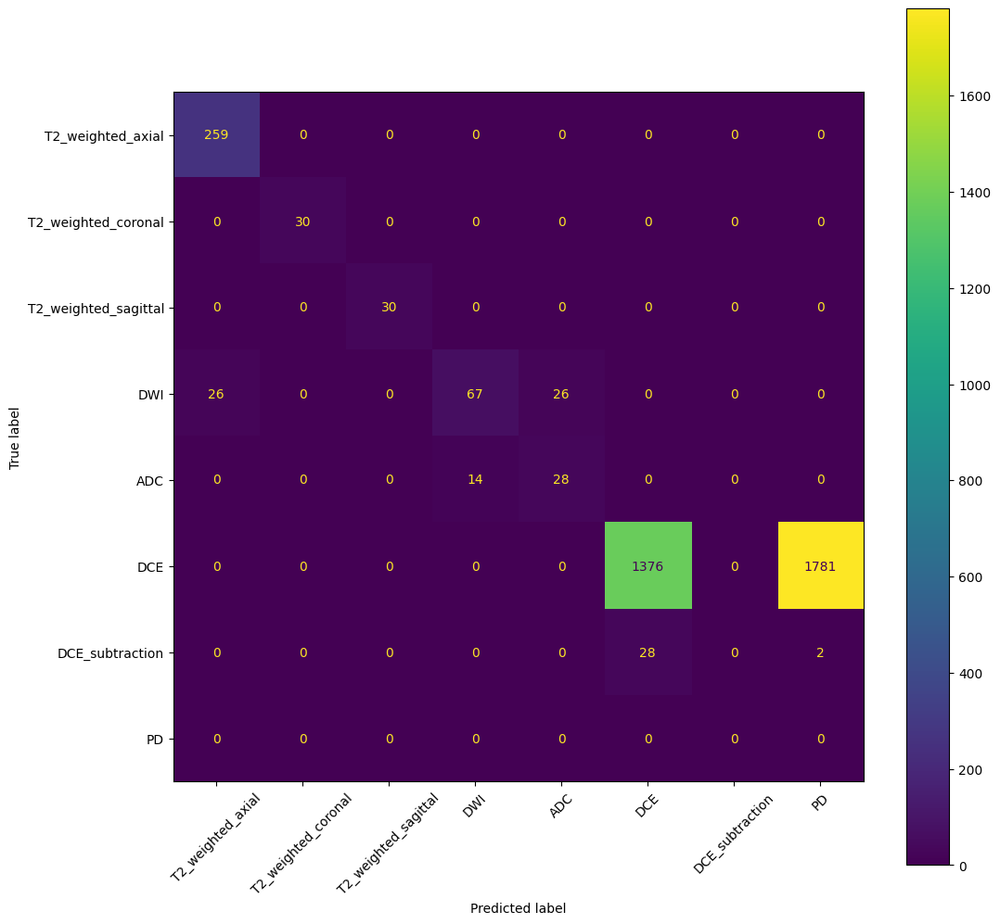

In [ ]:
# Confusion matrix

from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

disp = ConfusionMatrixDisplay.from_predictions(
                  y_test, rf_pred,
                  labels=gt_values,
                  cmap=plt.cm.viridis,
                  display_labels=gt_strings,
                  values_format='',
)
fig = disp.ax_.get_figure()
fig.set_figwidth(12)
fig.set_figheight(12)
plt.xticks(rotation=45)

# Random forest classification - using the original T/F and the actual TR/TE/FA values

In [ ]:
gt_series = list(prostate_rules_df['normalized_series_description'].values)
print(gt_series)
num_gt_series = len(gt_series)

# concat each gt in order
df_gt_results_for_classification = pd.DataFrame()
for n in range(0,num_gt_series):
  df_temp = df_gt_results[df_gt_results['gt'] == gt_series[n]]
  df_gt_results_for_classification = pd.concat([df_gt_results_for_classification,df_temp])

# reset the index!
df_gt_results_for_classification = df_gt_results_for_classification.reset_index()

df_gt_results_for_classification.head()

['T2_weighted_axial', 'T2_weighted_coronal', 'T2_weighted_sagittal', 'DWI', 'ADC', 'DCE', 'DCE_subtraction', 'PD']


,index,SeriesInstanceUID,collection_id,SeriesDescription,PatientID,StudyInstanceUID,number_of_images,RepetitionTime,EchoTime,FlipAngle,...,has_scanningSequence_SE,has_scanningSequence_EP,has_scanningSequence_GR,ImageType_contains_DIFFUSION,ImageType_contains_ADC,ImageType_contains_PRIMARY,ImageType_contains_DERIVED,ImageType_contains_FFE,RepetitionTime_greater_than_1000,viewer_url
0,104,1.3.6.1.4.1.14519.5.2.1.9823.1001.319694498904...,prostate_mri,T2 TSE ax hi,MIP-PROSTATE-01-0001,1.3.6.1.4.1.14519.5.2.1.9823.1001.120983205477...,26,8868.7158203125,120,90,...,True,False,False,False,False,False,False,False,True,https://viewer.imaging.datacommons.cancer.gov/...
1,165,1.3.6.1.4.1.14519.5.2.1.9823.1001.278404398158...,prostate_mri,T2 TSE ax hi,MIP-PROSTATE-01-0002,1.3.6.1.4.1.14519.5.2.1.9823.1001.250423657931...,26,8868.7158203125,120,90,...,True,False,False,False,False,False,False,False,True,https://viewer.imaging.datacommons.cancer.gov/...
2,224,1.3.6.1.4.1.14519.5.2.1.9823.1001.262648657208...,prostate_mri,T2 TSE ax hi,MIP-PROSTATE-01-0003,1.3.6.1.4.1.14519.5.2.1.9823.1001.160190203877...,26,8868.7158203125,120,90,...,True,False,False,False,False,False,False,False,True,https://viewer.imaging.datacommons.cancer.gov/...
3,284,1.3.6.1.4.1.14519.5.2.1.9823.1001.253606160143...,prostate_mri,T2 TSE ax hi,MIP-PROSTATE-01-0004,1.3.6.1.4.1.14519.5.2.1.9823.1001.174531324172...,26,8868.71484375,120,90,...,True,False,False,False,False,False,False,False,True,https://viewer.imaging.datacommons.cancer.gov/...
4,341,1.3.6.1.4.1.14519.5.2.1.9823.1001.189165430196...,prostate_mri,T2 TSE ax hi,MIP-PROSTATE-01-0005,1.3.6.1.4.1.14519.5.2.1.9823.1001.605742041342...,26,8868.71484375,120,90,...,True,False,False,False,False,False,False,False,True,https://viewer.imaging.datacommons.cancer.gov/...


In [ ]:
# Keep the True/False

# first create dataframe solely for classification
# df_gt_results_for_classification = df_gt_results.copy(deep=True)
df_results_for_classification = df_gt_results_for_classification[['is_axial', 'is_coronal', 'is_sagittal',
                                                                     'has_multiple_orientations', 'has_greater_than_10_images', 'is_4D',
                                                                     'has_scanningSequence_SE', 'has_scanningSequence_EP', 'has_scanningSequence_GR',
                                                                     'ImageType_contains_DIFFUSION', 'ImageType_contains_ADC',
                                                                     'ImageType_contains_PRIMARY', 'ImageType_contains_DERIVED',
                                                                     'ImageType_contains_FFE',
                                                                     'RepetitionTime_greater_than_1000', 'has_contrast',
                                                                     # include the scanning parameters
                                                                     'RepetitionTime', 'EchoTime', 'FlipAngle']]

df_results_for_classification_binary = df_results_for_classification.copy(deep=True)
# df_results_for_classification_binary.replace({False: 0, True: 1}, inplace=True)
df_results_for_classification_binary.head()

,is_axial,is_coronal,is_sagittal,has_multiple_orientations,has_greater_than_10_images,is_4D,has_scanningSequence_SE,has_scanningSequence_EP,has_scanningSequence_GR,ImageType_contains_DIFFUSION,ImageType_contains_ADC,ImageType_contains_PRIMARY,ImageType_contains_DERIVED,ImageType_contains_FFE,RepetitionTime_greater_than_1000,has_contrast,RepetitionTime,EchoTime,FlipAngle
0,True,False,False,False,True,False,True,False,False,False,False,False,False,False,True,False,8868.7158203125,120,90
1,True,False,False,False,True,False,True,False,False,False,False,False,False,False,True,False,8868.7158203125,120,90
2,True,False,False,False,True,False,True,False,False,False,False,False,False,False,True,False,8868.7158203125,120,90
3,True,False,False,False,True,False,True,False,False,False,False,False,False,False,True,False,8868.71484375,120,90
4,True,False,False,False,True,False,True,False,False,False,False,False,False,False,True,False,8868.71484375,120,90


In [ ]:
num_series = len(df_results_for_classification_binary)
print('num_series: ' + str(num_series))

pred_array = np.asarray(df_results_for_classification_binary)
print(pred_array.shape)

num_series: 24144
(24144, 19)


In [ ]:
# First convert the ground truth to list of integers

gt_strings = prostate_rules_df['normalized_series_description'].values
print('gt_strings ' + str(gt_strings))
# convert to integer values
gt_values = np.arange(0,len(gt_strings),1)
print('gt_values: ' + str(gt_values))

# create dictionary of these
gt_dict = {gt_strings[i]: gt_values[i] for i in range(len(gt_strings))}
print('gt_dict: ' + str(gt_dict))

y_true_str = df_gt_results_for_classification['gt'].values
y_true = [gt_dict[f] for f in y_true_str]
print('y_true_str shape: ' + str(y_true_str.shape))
print('y_true_str: ' + str(y_true_str))
print('y_true: ' + str(y_true))


gt_strings ['T2_weighted_axial' 'T2_weighted_coronal' 'T2_weighted_sagittal' 'DWI'
 'ADC' 'DCE' 'DCE_subtraction' 'PD']
gt_values: [0 1 2 3 4 5 6 7]
gt_dict: {'T2_weighted_axial': 0, 'T2_weighted_coronal': 1, 'T2_weighted_sagittal': 2, 'DWI': 3, 'ADC': 4, 'DCE': 5, 'DCE_subtraction': 6, 'PD': 7}
y_true_str shape: (24144,)
y_true_str: ['T2_weighted_axial' 'T2_weighted_axial' 'T2_weighted_axial' ... 'PD' 'PD'
 'PD']
y_true: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

In [ ]:
set(df_gt_results_for_classification['collection_id'].values)

{'prostate_3t',
 'prostate_diagnosis',
 'prostate_fused_mri_pathology',
 'prostate_mri',
 'prostate_mri_us_biopsy',
 'prostatex',
 'qin_prostate_repeatability'}

In [ ]:
from sklearn.ensemble import RandomForestClassifier

X = pred_array
y = np.asarray(y_true)
print(X.shape)
print(y.shape)

# collections for training
training_collections = ['prostatex']
testing_collections = ['qin_prostate_repeatability','prostate_diagnosis', 'prostate_mri', 'prostate_3t', 'prostate_fused_mri_pathology', 'prostate_mri_us_biopsy']

# train on prostate mri us biopsy and test on the rest for now:
indices = df_gt_results_for_classification[df_gt_results_for_classification['collection_id'].isin(training_collections)].index
print(len(indices))

X_train = X[indices,:]
y_train = y[indices]
print(X_train.shape)
print(y_train.shape)

clf = RandomForestClassifier(max_depth=None, random_state=0, oob_score=True)
clf.fit(X_train, y_train)


(24144, 19)
(24144,)
18389
(18389, 19)
(18389,)


RandomForestClassifier(oob_score=True, random_state=0)

In [ ]:
# Predict on rest

indices_predict = df_gt_results_for_classification[df_gt_results_for_classification['collection_id'].isin(testing_collections)].index
print(len(indices_predict))

X_test = X[indices_predict,:]
y_test = y[indices_predict]
print(X_test.shape)
print(y_test.shape)

5755
(5755, 19)
(5755,)


In [ ]:
rf_pred = clf.predict(X_test)
print('rf_pred shape: ' + str(rf_pred.shape))


rf_pred shape: (5755,)


In [ ]:
print(clf.oob_score_)

1.0


(array([0, 1, 2, 3, 4, 5, 6, 7]),
 [Text(0, 0, 'T2_weighted_axial'),
  Text(1, 0, 'T2_weighted_coronal'),
  Text(2, 0, 'T2_weighted_sagittal'),
  Text(3, 0, 'DWI'),
  Text(4, 0, 'ADC'),
  Text(5, 0, 'DCE'),
  Text(6, 0, 'DCE_subtraction'),
  Text(7, 0, 'PD')])

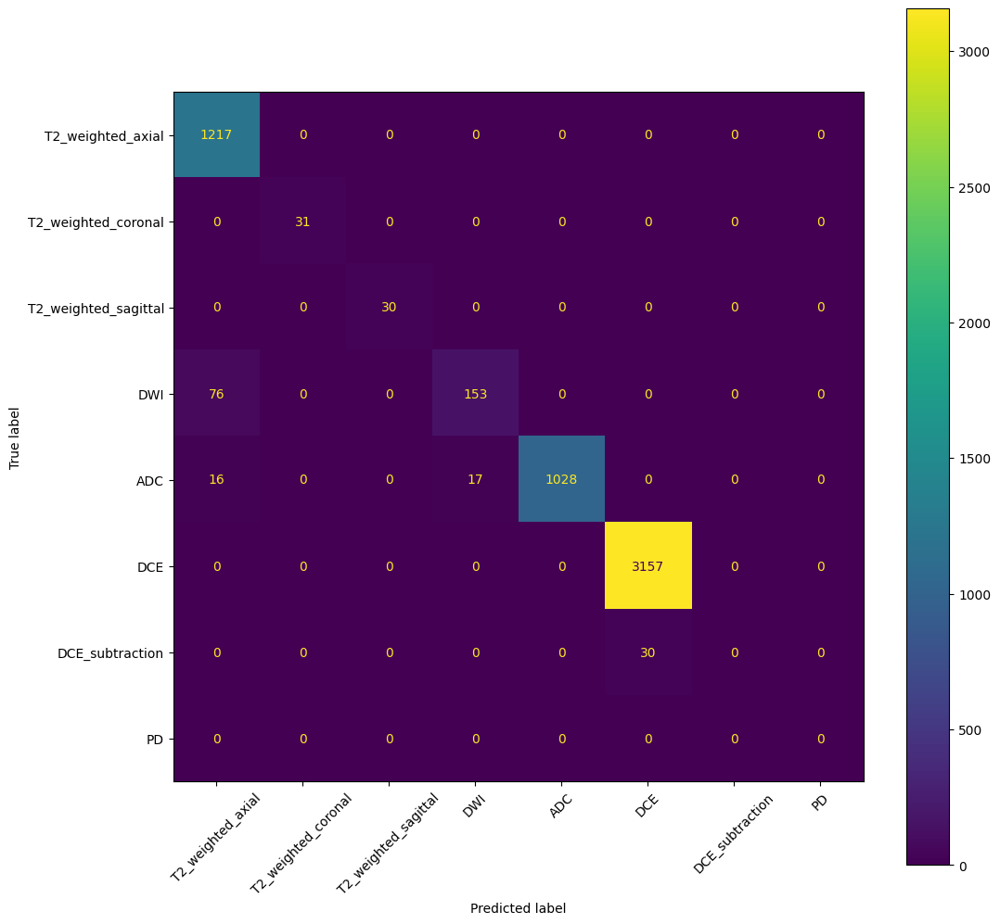

In [ ]:
# Confusion matrix

from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

disp = ConfusionMatrixDisplay.from_predictions(
                  y_test, rf_pred,
                  labels=gt_values,
                  cmap=plt.cm.viridis,
                  display_labels=gt_strings,
                  values_format='',
)
fig = disp.ax_.get_figure()
fig.set_figwidth(12)
fig.set_figheight(12)
plt.xticks(rotation=45)

In [ ]:
# Some sort of plot with training and testing on different sets of data?


## Analyze misclassifications wtih training on prostatex, testing on rest,


In [ ]:

# Where True = DWI and predicted = T2 weighted axial
# Where True = 3 and predicted = 0
true_dwi = np.where(y_test==3)[0]
pred_t2 = np.where(rf_pred==0)[0]
true_dwi_pred_t2_axial_indices = list(set(true_dwi) & set(pred_t2)) # 76 patients
print(len(true_dwi))
print(len(pred_t2))
print(len(true_dwi_pred_t2_axial_indices))

print(true_dwi_pred_t2_axial_indices)

# get the df of the original table these were part of
df_for_testing = df_gt_results_for_classification[df_gt_results_for_classification['collection_id'].isin(testing_collections)]
df_for_testing_true_dwi_pred_t2_axial = df_for_testing.iloc[true_dwi_pred_t2_axial_indices]


229
1309
76
[1280, 1281, 1282, 1283, 1284, 1285, 1286, 1287, 1288, 1289, 1290, 1291, 1292, 1293, 1294, 1295, 1296, 1297, 1298, 1299, 1300, 1301, 1302, 1303, 1304, 1305, 1306, 1307, 1308, 1309, 1310, 1311, 1312, 1313, 1314, 1315, 1316, 1317, 1318, 1319, 1320, 1321, 1322, 1323, 1324, 1325, 1326, 1327, 1328, 1329, 1452, 1458, 1459, 1460, 1461, 1462, 1463, 1465, 1466, 1467, 1468, 1469, 1413, 1362, 1418, 1376, 1377, 1419, 1390, 1391, 1394, 1395, 1422, 1398, 1278, 1279]


In [ ]:
pd.set_option('display.max_columns', None)
set(df_for_testing_true_dwi_pred_t2_axial['ImageType'].values)

{'ORIGINAL/PRIMARY/M_SE/M/SE',
 'ORIGINAL/PRIMARY/OTHER',
 'ORIGINAL/SECONDARY/ADC_UNSPECIFIED/ADC/UNSPECIFIED',
 'ORIGINAL/SECONDARY/M_SE/M/SE'}

In [ ]:
# Where True = ADC, and predicted = T2 weighted axial

true_adc = np.where(y_test==4)[0]
pred_t2 = np.where(rf_pred==0)[0]
true_adc_pred_t2_axial_indices = list(set(true_adc) & set(pred_t2)) # 16 patients
print(len(true_adc_pred_t2_axial_indices))

# get the df of the original table these were part of
df_for_testing = df_gt_results_for_classification[df_gt_results_for_classification['collection_id'].isin(testing_collections)]
df_for_testing_true_adc_pred_t2_axial = df_for_testing.iloc[true_adc_pred_t2_axial_indices]

16


In [ ]:
set(df_for_testing_true_adc_pred_t2_axial['collection_id'].values)

{'prostate_fused_mri_pathology', 'prostate_mri_us_biopsy'}

In [ ]:
set(df_for_testing_true_adc_pred_t2_axial['ImageType'].values)

{'ORIGINAL/PRIMARY/ADC/ND',
 'ORIGINAL/PRIMARY/ADC_SE/ADC/SE',
 'ORIGINAL/PRIMARY/ADC_UNSPECIFIED/ADC/UNSPECIFIED',
 'ORIGINAL/PRIMARY/OTHER'}

In [ ]:
set(df_for_testing_true_adc_pred_t2_axial['ScanningSequence'].values)

{'EP', 'EP/SE', 'RM', 'SE'}

In [ ]:
# true = ADC, pred = DWI = 17

# Where True = 4 and predicted = 3
true_adc = np.where(y_test==4)[0]
pred_dwi = np.where(rf_pred==3)[0]
true_adc_pred_dwi_indices = list(set(true_adc) & set(pred_dwi)) # 17 patients
print(len(true_adc_pred_dwi_indices))

# get the df of the original table these were part of
df_for_testing = df_gt_results_for_classification[df_gt_results_for_classification['collection_id'].isin(testing_collections)]
df_for_testing_true_adc_pred_dwi = df_for_testing.iloc[true_adc_pred_dwi_indices]

17


In [ ]:
print(set(df_for_testing_true_adc_pred_dwi['collection_id'].values))
print(set(df_for_testing_true_adc_pred_dwi['ImageType'].values)) # no ADC in ImageType
print(set(df_for_testing_true_adc_pred_dwi['ScanningSequence'].values))

{'prostate_mri_us_biopsy', 'qin_prostate_repeatability'}
{'DERIVED/PRIMARY/DIFFUSION/TRACEW/DIS2D/DFC', 'DERIVED/SECONDARY/DECOMPRESSED', 'DERIVED/SECONDARY/PROCESSED', 'ORIGINAL/PRIMARY/OTHER'}
{'EP', 'EP/SE', 'EP/RM'}


In [ ]:
df_for_testing_true_adc_pred_dwi

,index,SeriesInstanceUID,collection_id,SeriesDescription,PatientID,StudyInstanceUID,number_of_images,RepetitionTime,EchoTime,FlipAngle,InversionTime,EchoTrainLength,TriggerTime,MRAcquisitionType,SequenceVariant,ScanOptions,ScanningSequence,SequenceName,ImageType,ContrastBolusAgent,Manufacturer,ManufacturerModelName,orientation_count,position_count,orientations,orientation_type,gt,is_localizer,is_4D,scanning_plane,has_contrast,is_axial,is_coronal,is_sagittal,has_multiple_orientations,has_greater_than_10_images,has_scanningSequence_SE,has_scanningSequence_EP,has_scanningSequence_GR,ImageType_contains_DIFFUSION,ImageType_contains_ADC,ImageType_contains_PRIMARY,ImageType_contains_DERIVED,ImageType_contains_FFE,RepetitionTime_greater_than_1000,viewer_url
4023,4084,1.3.6.1.4.1.14519.5.2.1.7806500933975183746226...,prostate_mri_us_biopsy,_ADC,Prostate-MRI-US-Biopsy-0289,1.3.6.1.4.1.14519.5.2.1.2921515346897743450163...,20,5150,67.8,90,None,1,None,2D,NONE,EDR_GEMS/EPI_GEMS/PFF,EP/RM,None,ORIGINAL/PRIMARY/OTHER,None,GE MEDICAL SYSTEMS,DISCOVERY MR750,1,20,1/0/0/0/0.974972/0.222326,single_orientation,ADC,False,False,axial,False,True,False,False,False,True,False,True,False,False,False,True,False,False,True,https://viewer.imaging.datacommons.cancer.gov/...
3736,1849,1.3.6.1.4.1.14519.5.2.1.3671.4754.273902160795...,qin_prostate_repeatability,Apparent Diffusion Coefficient,PCAMPMRI-00001,1.3.6.1.4.1.14519.5.2.1.3671.4754.288848219213...,20,2500,80.8,90,0,1,None,2D,NONE,EPI_GEMS/PFF,EP/SE,None,DERIVED/SECONDARY/PROCESSED,None,GE MEDICAL SYSTEMS,Signa HDxt,1,20,0.999629/0.0261847/0.00750752/-0.0272223/0.952...,single_orientation,ADC,False,False,axial,False,True,False,False,False,True,True,True,False,False,False,False,True,False,True,https://viewer.imaging.datacommons.cancer.gov/...
3735,1791,1.3.6.1.4.1.14519.5.2.1.3671.4754.265098529377...,qin_prostate_repeatability,Apparent Diffusion Coefficient,PCAMPMRI-00001,1.3.6.1.4.1.14519.5.2.1.3671.4754.121472087445...,20,3000,81.2,90,0,1,None,2D,NONE,EPI_GEMS/PFF,EP/SE,None,DERIVED/SECONDARY/PROCESSED,None,GE MEDICAL SYSTEMS,Signa HDxt,1,20,0.998513/0.0543233/-0.00460834/-0.0540488/0.99...,single_orientation,ADC,False,False,axial,False,True,False,False,False,True,True,True,False,False,False,False,True,False,True,https://viewer.imaging.datacommons.cancer.gov/...
3737,1908,1.3.6.1.4.1.14519.5.2.1.3671.4754.306182248785...,qin_prostate_repeatability,Apparent Diffusion Coefficient,PCAMPMRI-00002,1.3.6.1.4.1.14519.5.2.1.3671.4754.304001015100...,20,3000,80.5,90,0,1,None,2D,NONE,EPI_GEMS/PFF,EP/SE,None,DERIVED/SECONDARY/PROCESSED,None,GE MEDICAL SYSTEMS,Signa HDxt,1,20,1/-0/0/-0/0.951468/0.307746,single_orientation,ADC,False,False,axial,False,True,False,False,False,True,True,True,False,False,False,False,True,False,True,https://viewer.imaging.datacommons.cancer.gov/...
3738,1964,1.3.6.1.4.1.14519.5.2.1.3671.4754.134570230168...,qin_prostate_repeatability,Apparent Diffusion Coefficient,PCAMPMRI-00002,1.3.6.1.4.1.14519.5.2.1.3671.4754.568383070573...,16,2500,80.6,90,0,1,None,2D,NONE,EPI_GEMS/PFF,EP/SE,None,DERIVED/SECONDARY/PROCESSED,None,GE MEDICAL SYSTEMS,Signa HDxt,1,16,0.999342/-0.00900315/-0.0351273/0.0169071/0.97...,single_orientation,ADC,False,False,axial,False,True,False,False,False,True,True,True,False,False,False,False,True,False,True,https://viewer.imaging.datacommons.cancer.gov/...
4604,5823,1.3.6.1.4.1.14519.5.2.1.1701242614624688595841...,prostate_mri_us_biopsy,AX DWI B_50 B_400 B_800_ADC,Prostate-MRI-US-Biopsy-0918,1.3.6.1.4.1.14519.5.2.1.3382055175779358430585...,21,3400,90,90,None,1,None,2D,SK/SP/OSP,PFP/FS,EP,*ep_b50_800,DERIVED/SECONDARY/DECOMPRESSED,None,SIEMENS,Verio,1,21,0.99973489250985/0.00250738929702/-0.022887937...,single_orientation,ADC,False,False,axial,False,True,False,False,False,True,False,True,False,False,False,False,True,False,True,https://viewer.imaging.datacommons.cancer.gov/...
3739,2078,1.3.6.1.4.1.14519.5.2.1.3671.4754.179470327513...,qin_prostate_repeatability,Apparen

# Random forest classification 3 - Use the original T/F, and actual values for TR/TE/FA and ImageType